# パッケージインストール

In [ ]:
!pip install -U transformers flash_attn timm

# モデル準備

In [ ]:
import torch
from transformers import AutoProcessor, AutoModelForCausalLM

device = 'cuda:0'  # 'cpu'

# model_name = "microsoft/Florence-2-base"
model_name = "microsoft/Florence-2-large"
# model_name = "microsoft/Florence-2-base-ft"
# model_name = "microsoft/Florence-2-large-ft"

# モデルとプロセッサの準備
model = AutoModelForCausalLM.from_pretrained(
    model_name,
    torch_dtype=torch.float16,
    trust_remote_code=True
).to(device)
processor = AutoProcessor.from_pretrained(
    model_name,
    trust_remote_code=True
)

# 推論用関数準備

In [ ]:
def run_inference(
    input_image,
    task_prompt,
    text_input=None,
    max_new_tokens=1024,
    num_beams=3,
    do_sample=False,
    temperature=None,
    device='cpu'
):
    # 入力プロンプト準備
    if text_input is None:
        prompt = task_prompt
    else:
        prompt = task_prompt + text_input
    inputs = processor(text=prompt, images=input_image, return_tensors="pt").to(device, torch.float16)

    image_width, image_height = input_image.shape[1], input_image.shape[0]

    # 推論
    generated_ids = model.generate(
        input_ids=inputs["input_ids"],
        pixel_values=inputs["pixel_values"],
        max_new_tokens=max_new_tokens,
        num_beams=num_beams,
        do_sample=do_sample,
        temperature=temperature,
    )

    # デコード
    generated_text = processor.batch_decode(generated_ids, skip_special_tokens=False)[0]
    result = processor.post_process_generation(
        generated_text,
        task=task_prompt,
        image_size=(image_width, image_height),
    )

    return result

# 描画用関数準備

In [ ]:
import copy

import cv2
import numpy as np

def get_id_color(index):
    temp_index = abs(int(index + 5)) * 3
    color = (
        (37 * temp_index) % 255,
        (17 * temp_index) % 255,
        (29 * temp_index) % 255,
    )
    return color

def draw_bboxes(bgr_image, bboxes, labels, thickness=2):
    debug_image = copy.deepcopy(bgr_image)

    class_name_dict = {}

    for bbox, label in zip(bboxes, labels):
        # クラス名とIDを整理
        if label not in class_name_dict:
            new_id = len(class_name_dict)
            class_name_dict[label] = new_id

        # bbox
        x1, y1, x2, y2 = bbox
        x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
        color = get_id_color(int(class_name_dict[label]))
        cv2.rectangle(
            debug_image,
            (x1, y1),
            (x2, y2),
            color,
            thickness=thickness,
        )

        # label
        cv2.putText(
            debug_image,
            label,
            (x1, y1 - 5),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.8,
            color,
            thickness=thickness,
        )

    return debug_image, class_name_dict

def draw_quad_bboxes(bgr_image, quad_bboxes, labels, thickness=2):
    debug_image = copy.deepcopy(bgr_image)

    class_name_dict = {}

    for quad_bbox, label in zip(quad_bboxes, labels):
        # クラス名とIDを整理
        if label not in class_name_dict:
            new_id = len(class_name_dict)
            class_name_dict[label] = new_id

        # bbox
        x1, y1, x2, y2, x3, y3, x4, y4 = quad_bbox
        x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
        x3, y3, x4, y4 = int(x3), int(y3), int(x4), int(y4)
        color = get_id_color(int(class_name_dict[label]))

        cv2.line(debug_image, (x1, y1), (x2, y2), color=color, thickness=thickness)
        cv2.line(debug_image, (x2, y2), (x3, y3), color=color, thickness=thickness)
        cv2.line(debug_image, (x3, y3), (x4, y4), color=color, thickness=thickness)
        cv2.line(debug_image, (x4, y4), (x1, y1), color=color, thickness=thickness)

        # label
        cv2.putText(
            debug_image,
            label,
            (x1, y1 - 5),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.8,
            color,
            thickness=thickness,
        )

    return debug_image, class_name_dict

def draw_segmentation(bgr_image, polygons, labels, thickness=2, fill_poly=True):
    debug_image = copy.deepcopy(bgr_image)

    class_name_dict = {}

    for polygon, label in zip(polygons, labels):
        # クラス名とIDを整理
        if label not in class_name_dict:
            new_id = len(class_name_dict)
            class_name_dict[label] = new_id

        # polygon
        for polygon in polygons:
            polygon = np.array(polygon).reshape(-1, 2)
            if len(polygon) < 3:
                continue

            polygon = polygon.astype(int)
            polygon = polygon.reshape((-1, 1, 2))

            color = get_id_color(int(class_name_dict[label]))
            cv2.polylines(
                debug_image,
                [polygon],
                isClosed=True,
                color=color,
                thickness=thickness,
            )
            if fill_poly:
                cv2.fillPoly(
                    debug_image,
                    [polygon],
                    color=color,
                )

    return debug_image, class_name_dict

# サンプル画像準備

In [ ]:
!wget https://user0514.cdnw.net/shared/img/thumb/09.Night_Snap_1_TP_V.jpg -O sample.jpg

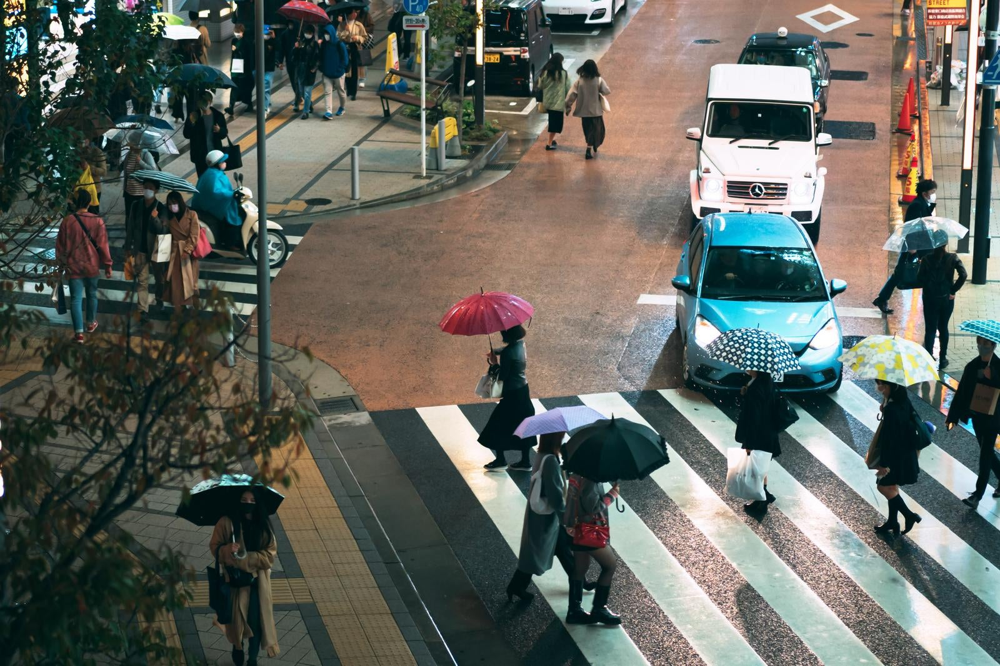

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

bgr_image = cv2.imread('sample.jpg')
rgb_image = cv2.cvtColor(bgr_image, cv2.COLOR_BGR2RGB)
cv2_imshow(bgr_image)

# プロンプト：キャプション

In [31]:
%%time

# キャプション
prompt = "<CAPTION>"
result = run_inference(rgb_image, prompt, device=device)
print(result)

{'<CAPTION>': 'A group of people crossing a street with umbrellas.'}
CPU times: user 420 ms, sys: 1.1 ms, total: 421 ms
Wall time: 421 ms


In [32]:
%%time

# 詳細なキャプション
prompt = "<DETAILED_CAPTION>"
result = run_inference(rgb_image, prompt, device=device)
print(result)

{'<DETAILED_CAPTION>': 'The image shows a group of people walking across a crosswalk with umbrellas, surrounded by vehicles on the road, poles, boards, traffic cones, plants, trees, and buildings in the background.'}
CPU times: user 978 ms, sys: 4.15 ms, total: 982 ms
Wall time: 981 ms


In [33]:
%%time

# より詳細なキャプション
prompt = "<MORE_DETAILED_CAPTION>"
result = run_inference(rgb_image, prompt, device=device)
print(result)

{'<MORE_DETAILED_CAPTION>': 'The image shows a busy street scene in a city. There are multiple vehicles on the road, including a blue car and a white van. The street is lined with trees and buildings, and there are people walking on the sidewalk, some of them holding umbrellas to protect themselves from the rain. The sky is overcast and the overall mood of the image is gloomy.'}
CPU times: user 1.66 s, sys: 7.85 ms, total: 1.67 s
Wall time: 2.48 s


# プロンプト：物体検出

In [34]:
%%time

# 物体検出
prompt = "<OD>"
result = run_inference(rgb_image, prompt, device=device)
print(result)

{'<OD>': {'bboxes': [[1069.5999755859375, 335.2569885253906, 1362.4000244140625, 633.7369995117188], [1092.0, 100.73699951171875, 1336.800048828125, 366.1709899902344], [1175.2000732421875, 44.23899841308594, 1332.0, 184.9510040283203], [941.6000366210938, 937.5469970703125, 999.2000122070312, 1003.6389770507812], [807.2000122070312, 915.1610107421875, 858.4000244140625, 966.3289794921875], [1188.0, 790.43896484375, 1244.0, 824.5509643554688], [943.2000122070312, 970.5929565429688, 999.2000122070312, 1003.6389770507812], [1437.5999755859375, 821.3529663085938, 1477.5999755859375, 857.5969848632812], [903.2000122070312, 975.9229736328125, 952.7999877929688, 1001.5069580078125], [1392.800048828125, 478.1009826660156, 1432.800048828125, 503.68499755859375], [1394.4000244140625, 835.2109985351562, 1439.2000732421875, 856.531005859375], [770.4000244140625, 735.0070190429688, 813.6000366210938, 753.1289672851562], [810.4000244140625, 740.3369750976562, 855.2000122070312, 757.3930053710938], 

{'car': 0, 'footwear': 1, 'land vehicle': 2, 'person': 3, 'wheel': 4, 'woman': 5}


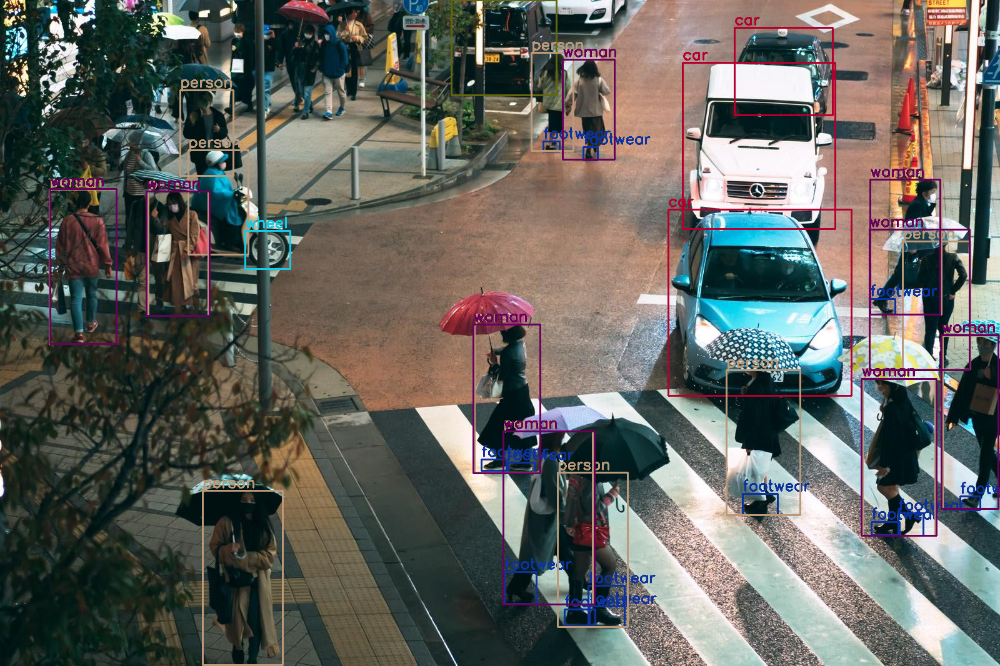

In [ ]:
debug_image, class_name_dict = draw_bboxes(
    bgr_image,
    result['<OD>']['bboxes'],
    result['<OD>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

In [35]:
%%time

# 高密度領域キャプション
prompt = "<DENSE_REGION_CAPTION>"
result = run_inference(rgb_image, prompt, device=device)
print(result)

{'<DENSE_REGION_CAPTION>': {'bboxes': [[1069.5999755859375, 335.2569885253906, 1362.4000244140625, 633.7369995117188], [1092.0, 100.73699951171875, 1336.800048828125, 366.1709899902344], [805.6000366210938, 690.2349853515625, 951.2000122070312, 967.3949584960938], [324.0, 785.1090087890625, 452.0, 1064.4010009765625], [757.6000366210938, 519.6749877929688, 864.7999877929688, 756.3269653320312], [1378.4000244140625, 606.02099609375, 1492.0, 857.5969848632812], [1162.4000244140625, 592.1629638671875, 1279.2000732421875, 824.5509643554688], [892.0, 756.3269653320312, 1000.7999877929688, 1003.6389770507812], [1394.4000244140625, 287.2869873046875, 1508.0, 503.68499755859375], [1508.0, 537.7969970703125, 1597.5999755859375, 814.9569702148438], [80.80000305175781, 303.2770080566406, 184.8000030517578, 551.6549682617188], [1439.2000732421875, 385.3590087890625, 1552.800048828125, 591.0969848632812], [892.0, 663.5849609375, 1076.0, 777.64697265625], [757.6000366210938, 564.447021484375, 863.20

{'blue car with polka dot umbrella on city street': 0, 'Mercedes-Benz Sprinter van on rainy street': 1, 'woman with red purse and black rain boots on street with umbrella': 2, 'woman with black umbrella on rainy day': 3, 'woman with pink umbrella on street': 4, 'woman with umbrella on zebra crossing': 5, 'woman with shopping bag on zigzag patterned street': 6, 'woman with burgundy handbag and red purse on street': 7, 'woman with blue and white umbrella on busy street': 8, 'woman with yellow and black umbrella walking on street': 9, 'woman with brown coat and red handbag on street': 10, 'woman with green and white polka-dot umbrella on snowy street': 11, "black umbrella on person's shoulder": 12, 'woman with colorful umbrella on sidewalk': 13, 'black car with white roof on rainy road': 14, 'woman with beige coat and brown coat on street': 15, 'person with red umbrella on red carpet': 16, 'person with blue umbrella on bus stop': 17, 'person with yellow umbrella on yellow and white stripe

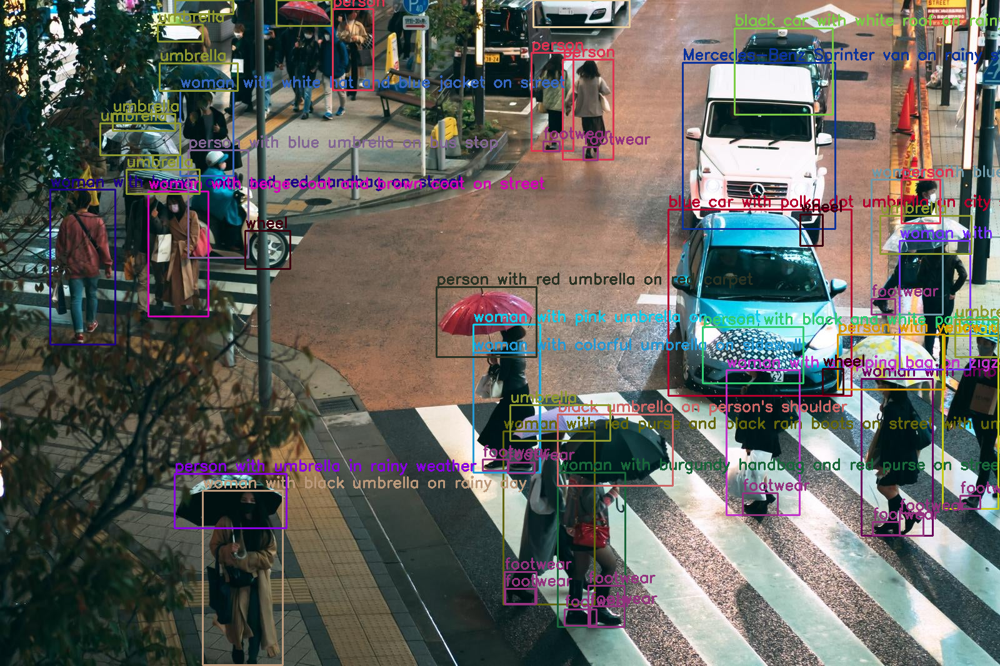

In [ ]:
debug_image, class_name_dict = draw_bboxes(
    bgr_image,
    result['<DENSE_REGION_CAPTION>']['bboxes'],
    result['<DENSE_REGION_CAPTION>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

In [36]:
%%time

# 領域提案
prompt = "<REGION_PROPOSAL>"
result = run_inference(rgb_image, prompt, device=device)
print(result)

{'<REGION_PROPOSAL>': {'bboxes': [[0.800000011920929, 0.5329999923706055, 1597.5999755859375, 1064.4010009765625], [0.800000011920929, 0.5329999923706055, 604.0, 550.5889892578125], [0.800000011920929, 0.5329999923706055, 602.4000244140625, 207.3369903564453], [1069.5999755859375, 335.2569885253906, 1364.0, 633.7369995117188], [1092.0, 100.73699951171875, 1336.800048828125, 366.1709899902344], [0.800000011920929, 0.5329999923706055, 600.7999877929688, 108.1989974975586], [0.800000011920929, 0.5329999923706055, 599.2000122070312, 69.822998046875], [805.6000366210938, 690.2349853515625, 952.7999877929688, 967.3949584960938], [999.2000122070312, 1002.572998046875, 1436.0, 821.3529663085938], [1477.5999755859375, 857.5969848632812, 903.2000122070312, 975.9229736328125], [954.4000244140625, 1001.5069580078125, 810.4000244140625, 942.8770141601562], [856.7999877929688, 967.3949584960938, 1394.4000244140625, 478.1009826660156], [1432.800048828125, 503.68499755859375, 1394.4000244140625, 835.2

{'': 0}


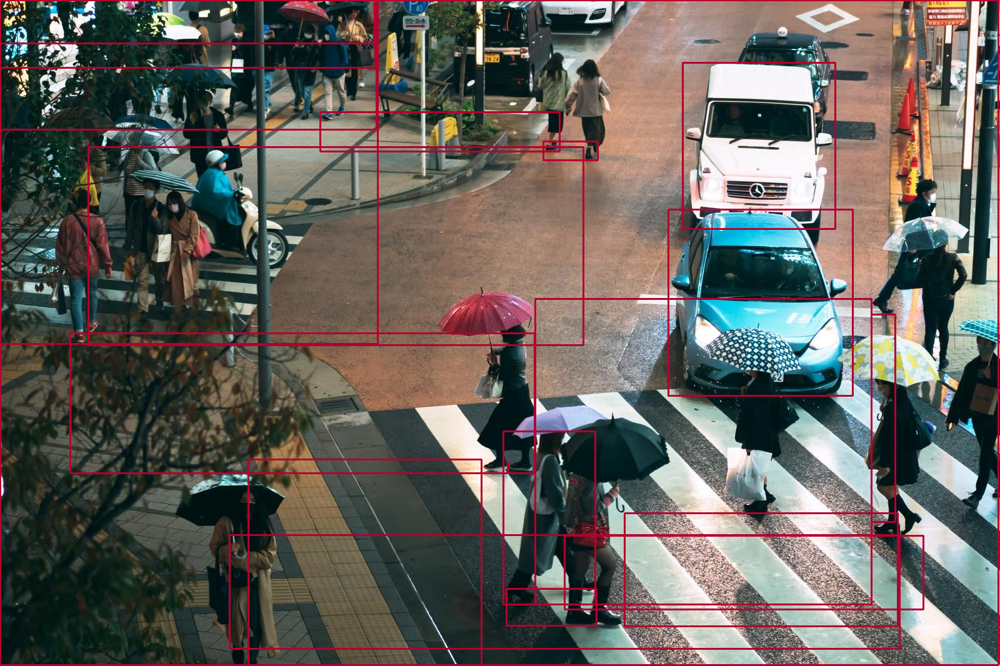

In [ ]:
debug_image, class_name_dict = draw_bboxes(
    bgr_image,
    result['<REGION_PROPOSAL>']['bboxes'],
    result['<REGION_PROPOSAL>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

In [37]:
%%time

# キャプションからフレーズへの接地
prompt = "<CAPTION_TO_PHRASE_GROUNDING>"
text_input = 'woman'
result = run_inference(rgb_image, prompt, text_input, device=device)
print(result)

{'<CAPTION_TO_PHRASE_GROUNDING>': {'bboxes': [[330.3999938964844, 781.9110107421875, 450.3999938964844, 1064.4010009765625], [807.2000122070312, 689.1690063476562, 917.6000366210938, 968.4609985351562], [896.7999877929688, 752.06298828125, 999.2000122070312, 1004.7049560546875], [1381.5999755859375, 604.9550170898438, 1484.0, 860.7949829101562], [85.5999984741211, 300.0790100097656, 183.1999969482422, 552.7210083007812], [762.4000244140625, 518.6090087890625, 860.0, 758.458984375], [1170.4000244140625, 590.031005859375, 1258.4000244140625, 826.6829833984375], [250.40000915527344, 304.3429870605469, 325.6000061035156, 509.0149841308594], [903.2000122070312, 94.34099578857422, 980.0, 257.4389953613281], [855.2000122070312, 83.68099975585938, 914.4000244140625, 243.58099365234375]], 'labels': ['woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman']}}
CPU times: user 729 ms, sys: 2.96 ms, total: 732 ms
Wall time: 730 ms


{'woman': 0}


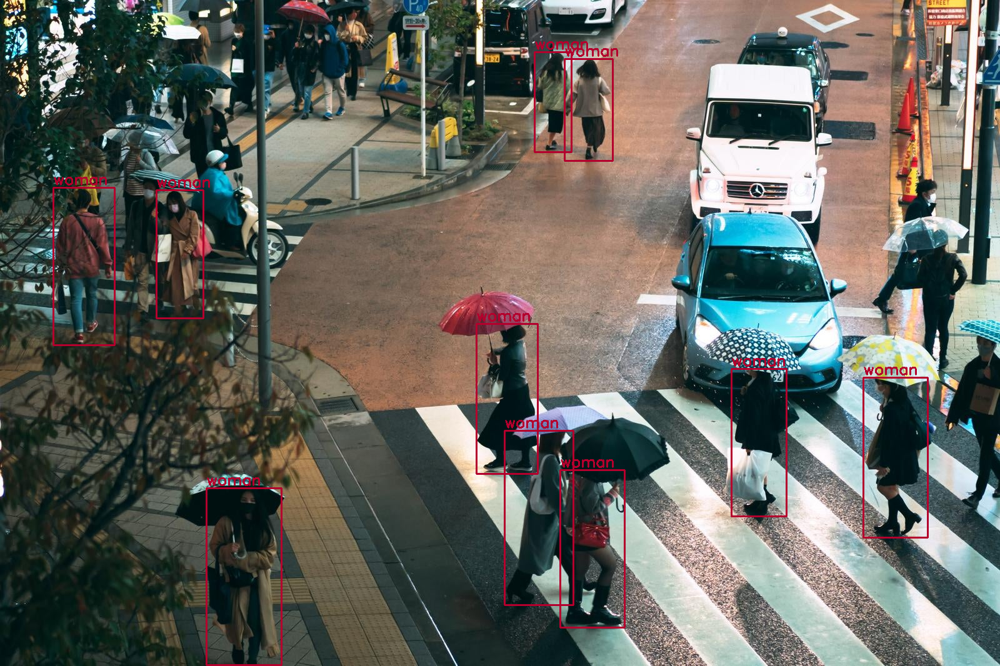

In [ ]:
debug_image, class_name_dict = draw_bboxes(
    bgr_image,
    result['<CAPTION_TO_PHRASE_GROUNDING>']['bboxes'],
    result['<CAPTION_TO_PHRASE_GROUNDING>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

In [38]:
%%time

# オープンボキャブラリー物体検出
prompt = "<OPEN_VOCABULARY_DETECTION>"
text_input = 'woman'
result = run_inference(rgb_image, prompt, text_input, device=device)
print(result)

{'<OPEN_VOCABULARY_DETECTION>': {'bboxes': [[805.6000366210938, 690.2349853515625, 951.2000122070312, 967.3949584960938], [325.6000061035156, 785.1090087890625, 452.0, 1064.4010009765625], [1380.0, 606.02099609375, 1496.800048828125, 857.5969848632812], [892.0, 756.3269653320312, 1004.0, 1003.6389770507812], [1165.5999755859375, 592.1629638671875, 1279.2000732421875, 823.4849853515625], [759.2000122070312, 519.6749877929688, 864.7999877929688, 756.3269653320312], [232.8000030517578, 306.4750061035156, 332.0, 505.8169860839844], [900.0, 95.40699768066406, 983.2000122070312, 255.30699157714844], [850.4000244140625, 84.74700164794922, 919.2000122070312, 241.44898986816406]], 'bboxes_labels': ['woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman', 'woman'], 'polygons': [], 'polygons_labels': []}}
CPU times: user 700 ms, sys: 962 µs, total: 701 ms
Wall time: 698 ms


{'woman': 0}
{}


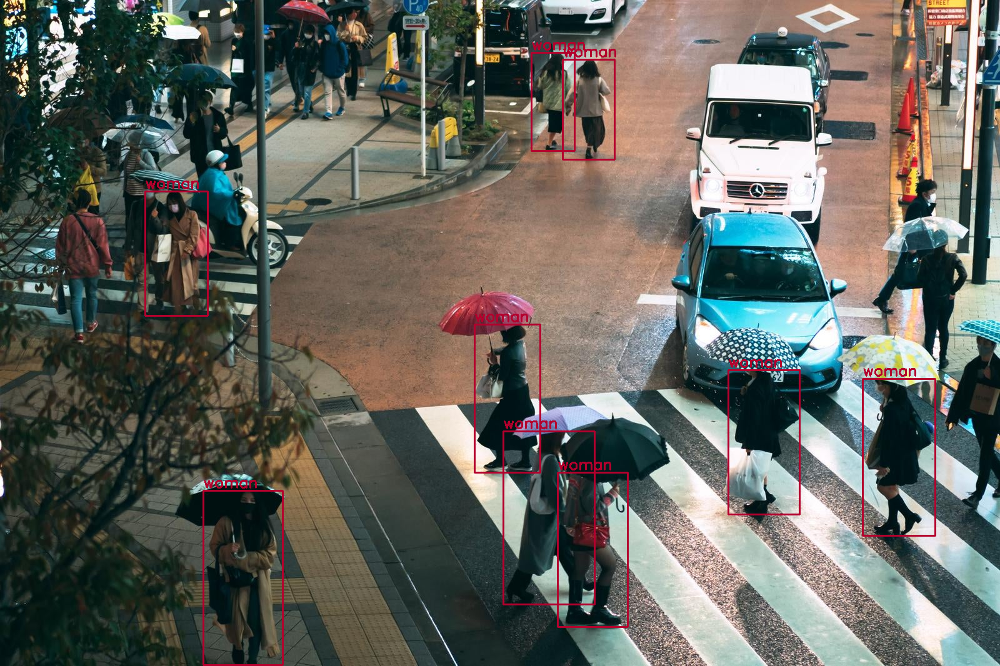

In [ ]:
debug_image, bboxes_class_name_dict = draw_bboxes(
    bgr_image,
    result['<OPEN_VOCABULARY_DETECTION>']['bboxes'],
    result['<OPEN_VOCABULARY_DETECTION>']['bboxes_labels'],
)
debug_image, polygons_class_name_dict = draw_segmentation(
    debug_image,
    result['<OPEN_VOCABULARY_DETECTION>']['polygons'],
    result['<OPEN_VOCABULARY_DETECTION>']['polygons_labels'],
)

print(bboxes_class_name_dict)
print(polygons_class_name_dict)
cv2_imshow(debug_image)

# プロンプト：セグメンテーション

In [39]:
%%time

# 参照セグメンテーション
prompt = "<REFERRING_EXPRESSION_SEGMENTATION>"
text_input = 'road'
result = run_inference(rgb_image, prompt, text_input, device=device)
print(result)

{'<REFERRING_EXPRESSION_SEGMENTATION>': {'polygons': [[[504.8000183105469, 359.7749938964844, 516.0, 356.5769958496094, 532.0, 354.44500732421875, 541.6000366210938, 351.24700927734375, 557.6000366210938, 349.114990234375, 567.2000122070312, 346.9830017089844, 583.2000122070312, 344.8509826660156, 594.4000244140625, 342.718994140625, 610.4000244140625, 340.5870056152344, 620.0, 338.4549865722656, 636.0, 336.322998046875, 645.6000366210938, 334.1910095214844, 660.0, 332.0589904785156, 669.6000366210938, 329.927001953125, 684.0, 327.79498291015625, 692.0, 325.6629943847656, 704.7999877929688, 323.531005859375, 716.0, 320.3330078125, 725.6000366210938, 318.20098876953125, 735.2000122070312, 315.00299072265625, 743.2000122070312, 311.80499267578125, 752.7999877929688, 309.6730041503906, 760.7999877929688, 306.4750061035156, 768.7999877929688, 303.2770080566406, 776.7999877929688, 301.1449890136719, 784.7999877929688, 297.9469909667969, 792.7999877929688, 293.6829833984375, 800.799987792968

{'': 0}


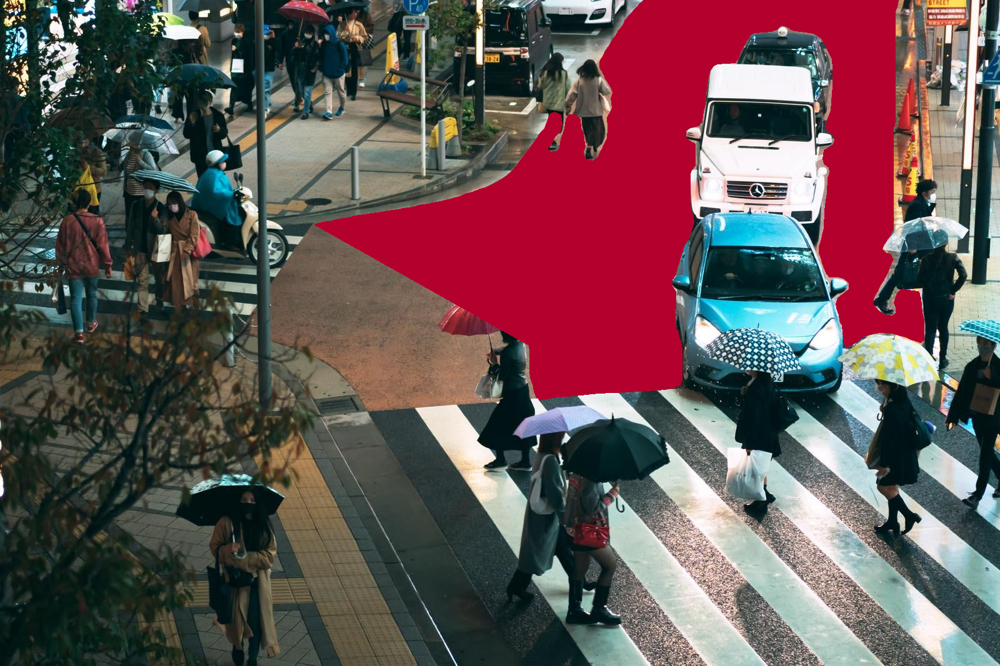

In [ ]:
debug_image, class_name_dict = draw_segmentation(
    bgr_image,
    result['<REFERRING_EXPRESSION_SEGMENTATION>']['polygons'],
    result['<REFERRING_EXPRESSION_SEGMENTATION>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

In [40]:
%%time

image_width, image_height = rgb_image.shape[1], rgb_image.shape[0]
target_x1, target_y1, target_x2, target_y2 = 1069, 335, 1362, 633
q_target_x1 = int(target_x1 / image_width * 999)
q_target_y1 = int(target_y1 / image_height * 999)
q_target_x2 = int(target_x2 / image_width * 999)
q_target_y2 = int(target_y2 / image_height * 999)

# 領域指定セグメンテーション
prompt = "<REGION_TO_SEGMENTATION>"
# フォーマット：'<loc_x1><loc_y1><loc_x2><loc_y2>', [x1, y1, x2, y2] is the quantized corrdinates in [0, 999].
text_input = '<loc_' + str(q_target_x1) + '><loc_' + str(q_target_y1) + '><loc_' + str(q_target_x2) + '><loc_' + str(q_target_y2) + '>'
print(text_input)
result = run_inference(rgb_image, prompt, text_input, device=device)
print(result)

<loc_667><loc_313><loc_850><loc_593>
{'<REGION_TO_SEGMENTATION>': {'polygons': [[[1122.4000244140625, 354.44500732421875, 1128.800048828125, 349.114990234375, 1132.0, 346.9830017089844, 1133.5999755859375, 345.9169921875, 1136.800048828125, 344.8509826660156, 1140.0, 343.7850036621094, 1143.2000732421875, 342.718994140625, 1148.0, 341.6529846191406, 1154.4000244140625, 340.5870056152344, 1162.4000244140625, 339.52099609375, 1168.800048828125, 339.52099609375, 1170.4000244140625, 340.5870056152344, 1189.5999755859375, 341.6529846191406, 1192.800048828125, 341.6529846191406, 1194.4000244140625, 340.5870056152344, 1197.5999755859375, 339.52099609375, 1200.800048828125, 339.52099609375, 1202.4000244140625, 340.5870056152344, 1205.5999755859375, 341.6529846191406, 1208.800048828125, 341.6529846191406, 1210.4000244140625, 340.5870056152344, 1213.5999755859375, 339.52099609375, 1216.800048828125, 339.52099609375, 1218.4000244140625, 340.5870056152344, 1221.5999755859375, 341.6529846191406, 12

{'': 0}


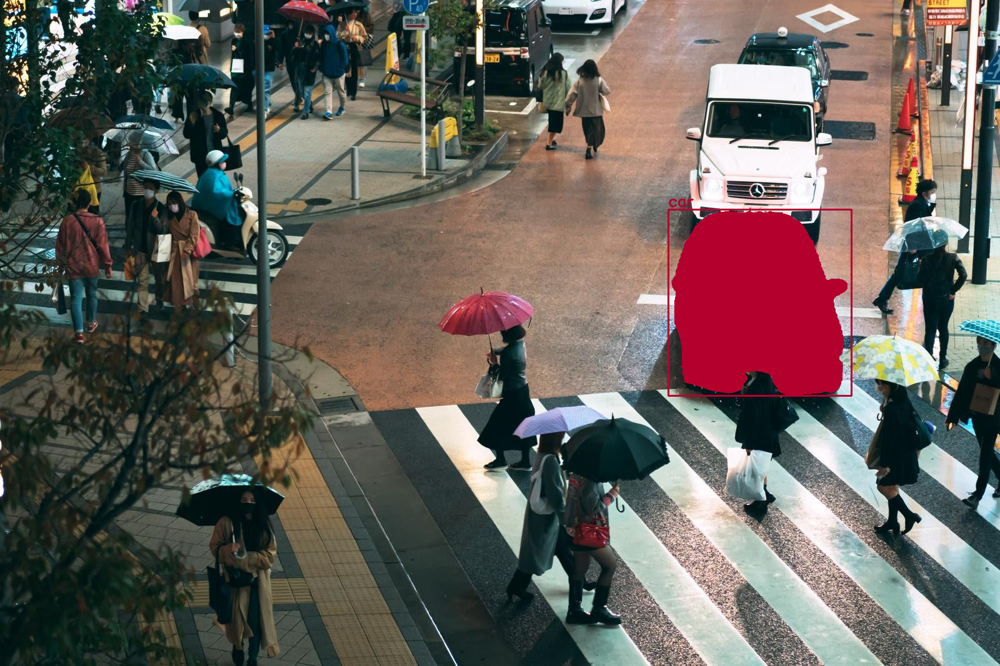

In [ ]:
debug_image, class_name_dict = draw_bboxes(
    bgr_image,
    [[target_x1, target_y1, target_x2, target_y2]],
    ['car'],
)
debug_image, class_name_dict = draw_segmentation(
    debug_image,
    result['<REGION_TO_SEGMENTATION>']['polygons'],
    result['<REGION_TO_SEGMENTATION>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)

# 領域→テキスト

In [41]:
%%time

image_width, image_height = rgb_image.shape[1], rgb_image.shape[0]
target_x1, target_y1, target_x2, target_y2 = 1069, 335, 1362, 633
q_target_x1 = int(target_x1 / image_width * 999)
q_target_y1 = int(target_y1 / image_height * 999)
q_target_x2 = int(target_x2 / image_width * 999)
q_target_y2 = int(target_y2 / image_height * 999)

# 領域→カテゴリー
prompt = "<REGION_TO_CATEGORY>"
# フォーマット：'<loc_x1><loc_y1><loc_x2><loc_y2>', [x1, y1, x2, y2] is the quantized corrdinates in [0, 999].
text_input = '<loc_' + str(q_target_x1) + '><loc_' + str(q_target_y1) + '><loc_' + str(q_target_x2) + '><loc_' + str(q_target_y2) + '>'
print(text_input)
result = run_inference(rgb_image, prompt, text_input, device=device)
print(result)

<loc_667><loc_313><loc_850><loc_593>
{'<REGION_TO_CATEGORY>': 'car<loc_667><loc_313><loc_850><loc_593>'}
CPU times: user 341 ms, sys: 52 µs, total: 341 ms
Wall time: 339 ms


In [42]:
%%time

image_width, image_height = rgb_image.shape[1], rgb_image.shape[0]
target_x1, target_y1, target_x2, target_y2 = 1069, 335, 1362, 633
q_target_x1 = int(target_x1 / image_width * 999)
q_target_y1 = int(target_y1 / image_height * 999)
q_target_x2 = int(target_x2 / image_width * 999)
q_target_y2 = int(target_y2 / image_height * 999)

# 領域→説明
prompt = "<REGION_TO_DESCRIPTION>"
# フォーマット：'<loc_x1><loc_y1><loc_x2><loc_y2>', [x1, y1, x2, y2] is the quantized corrdinates in [0, 999].
text_input = '<loc_' + str(q_target_x1) + '><loc_' + str(q_target_y1) + '><loc_' + str(q_target_x2) + '><loc_' + str(q_target_y2) + '>'
print(text_input)
result = run_inference(rgb_image, prompt, text_input, device=device)
print(result)

<loc_667><loc_313><loc_850><loc_593>
{'<REGION_TO_DESCRIPTION>': 'blue car with polka dot umbrella on street<loc_667><loc_313><loc_850><loc_593>'}
CPU times: user 426 ms, sys: 1.91 ms, total: 428 ms
Wall time: 424 ms


# OCR

In [ ]:
!wget https://user0514.cdnw.net/shared/img/thumb/yuta_240513_019_TP_V.jpg -O sample2.jpg

--2024-08-17 07:43:11--  https://user0514.cdnw.net/shared/img/thumb/yuta_240513_019_TP_V.jpg
Resolving user0514.cdnw.net (user0514.cdnw.net)... 139.162.75.187
Connecting to user0514.cdnw.net (user0514.cdnw.net)|139.162.75.187|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 295460 (289K) [image/jpeg]
Saving to: ‘sample2.jpg’

sample2.jpg         100%[===================>] 288.54K   921KB/s    in 0.3s    

2024-08-17 07:43:12 (921 KB/s) - ‘sample2.jpg’ saved [295460/295460]



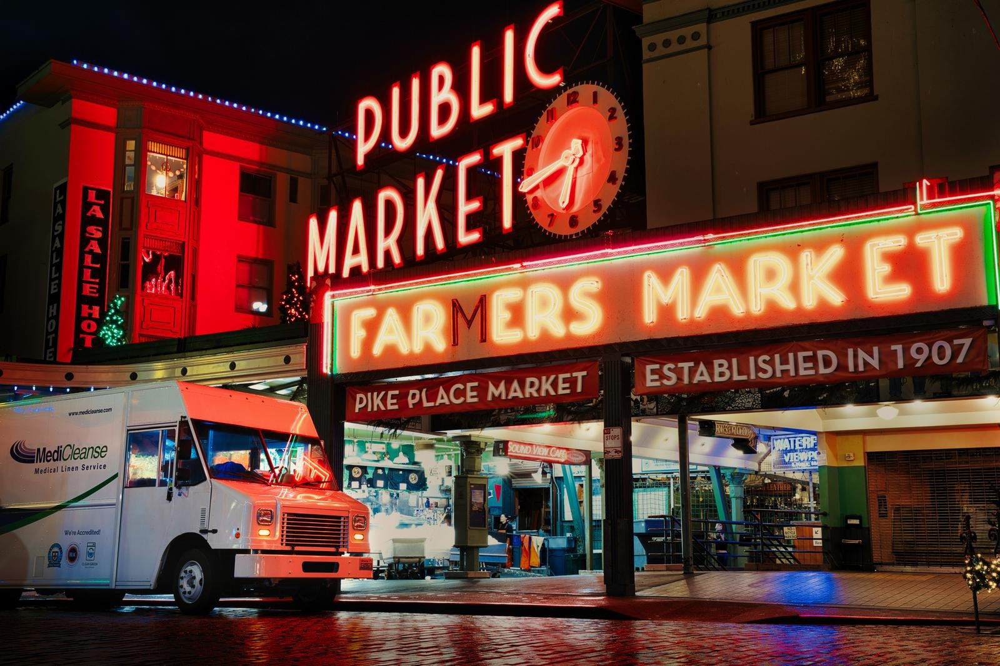

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

bgr_image2 = cv2.imread('sample2.jpg')
rgb_image2 = cv2.cvtColor(bgr_image2, cv2.COLOR_BGR2RGB)
cv2_imshow(bgr_image2)

In [43]:
%%time

# OCR
prompt = '<OCR>'
result = run_inference(rgb_image2, prompt, device=device)
print(result)

{'<OCR>': 'PUBLICMARKET3FARMERS MARKETPIKE PLACE MARKETESTABLISHED IN 1907www.needcleanse.comMediCleanseSOUND NEW CARSWATERPRMedical Linen ServiceMEMPHOREWire Iconsulted'}
CPU times: user 917 ms, sys: 22 µs, total: 917 ms
Wall time: 914 ms


In [44]:
%%time

# OCR（領域）
prompt = '<OCR_WITH_REGION>'
result = run_inference(rgb_image2, prompt, device=device)
print(result)

{'<OCR_WITH_REGION>': {'quad_boxes': [[520.7999877929688, 164.69699096679688, 895.2000122070312, 0.5329999923706055, 941.6000366210938, 129.5189971923828, 568.7999877929688, 279.8249816894531], [898.4000244140625, 150.83900451660156, 925.6000366210938, 144.4429931640625, 928.7999877929688, 164.69699096679688, 901.6000366210938, 171.09300231933594], [970.4000244140625, 173.22499084472656, 988.0, 172.15899658203125, 989.6000366210938, 192.41299438476562, 972.0, 193.47900390625], [976.7999877929688, 219.06300354003906, 996.0, 217.9969940185547, 997.6000366210938, 240.38299560546875, 978.4000244140625, 241.44898986816406], [458.3999938964844, 332.0589904785156, 911.2000122070312, 204.1389923095703, 948.0, 333.125, 500.0, 463.177001953125], [548.0, 490.89300537109375, 1540.0, 360.84100341796875, 1551.2000732421875, 466.375, 559.2000122070312, 581.5029907226562], [564.0, 626.2749633789062, 940.0, 591.0969848632812, 943.2000122070312, 632.6710205078125, 567.2000122070312, 664.6510009765625], 

{'</s>PUBLIC': 0, 'R': 1, '2': 2, '3': 3, 'MARKETO': 4, 'FARMERS MARKET': 5, 'PIKE PLACE MARKET': 6, 'ESTABLISHED IN 1907': 7, 'www.needcleanse.com': 8, 'MediCleanse': 9, 'SOUND VIEW CARS': 10, 'MEDICAL LITER SERVICE': 11, 'WATERF': 12, 'MEDICAL': 13, 'Wine Iconsulted': 14}


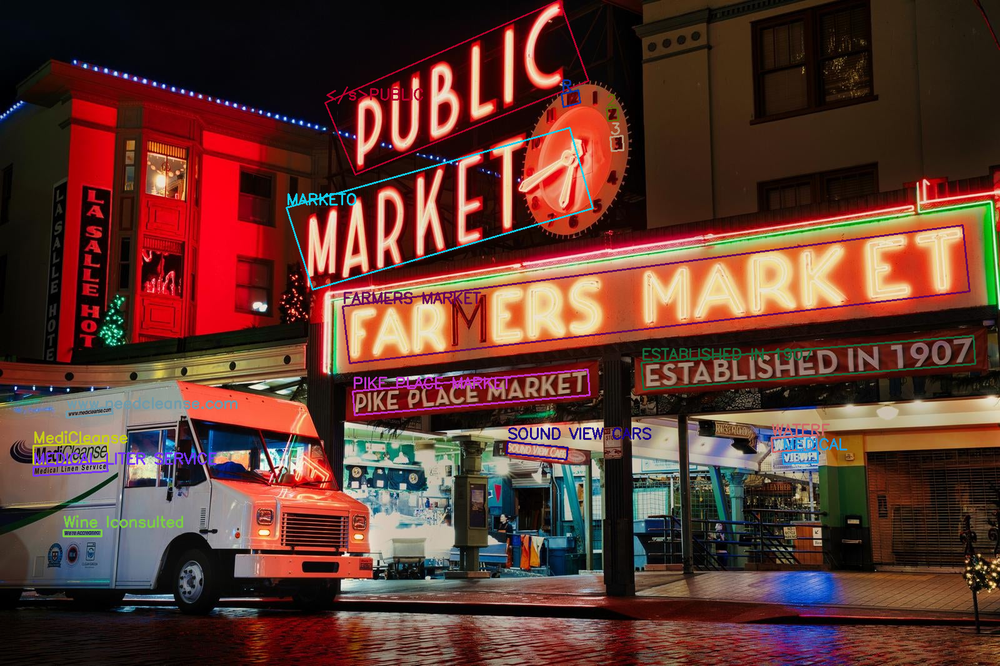

In [ ]:
debug_image, class_name_dict = draw_quad_bboxes(
    bgr_image2,
    result['<OCR_WITH_REGION>']['quad_boxes'],
    result['<OCR_WITH_REGION>']['labels'],
)

print(class_name_dict)
cv2_imshow(debug_image)